<a href="https://colab.research.google.com/github/Bavalpreet/BMU_Notebooks/blob/main/ml_models/linear_regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns

In [ ]:
data = pd.read_csv("insurance.csv")

In [ ]:
data

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


In [ ]:
data.describe()

,age,bmi,children,charges
count,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,30.663397,1.094918,13270.422265
std,14.049960,6.098187,1.205493,12110.011237
min,18.000000,15.960000,0.000000,1121.873900
25%,27.000000,26.296250,0.000000,4740.287150
50%,39.000000,30.400000,1.000000,9382.033000
75%,51.000000,34.693750,2.000000,16639.912515
max,64.000000,53.130000,5.000000,63770.428010


In [ ]:
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


## Take a look at categorical columns

In [ ]:
print(data.region.unique())
print(data.sex.unique())
print(data.smoker.unique())


['southwest' 'southeast' 'northwest' 'northeast']
['female' 'male']
['yes' 'no']


In [ ]:
data.corr() # by default we get pearson correlation which lies bw -1 to 1
# 1 means highly positve relation and -1 means negative relation
# https://www.geeksforgeeks.org/python-pandas-dataframe-corr/ refer this 

,age,bmi,children,charges
age,1.000000,0.109272,0.042469,0.299008
bmi,0.109272,1.000000,0.012759,0.198341
children,0.042469,0.012759,1.000000,0.067998
charges,0.299008,0.198341,0.067998,1.000000


In [ ]:
data.corr()['charges'].sort_values() # taking just charges column and sorting it

children    0.067998
bmi         0.198341
age         0.299008
charges     1.000000
Name: charges, dtype: float64

In [ ]:
data.dtypes

age           int64
sex          object
bmi         float64
children      int64
smoker       object
region       object
charges     float64
dtype: object

In [ ]:
encoded_data = pd.get_dummies(data, columns=["sex","smoker","region"])
encoded_data

,age,bmi,children,charges,sex_female,sex_male,smoker_no,smoker_yes,region_northeast,region_northwest,region_southeast,region_southwest
0,19,27.900,0,16884.92400,1,0,0,1,0,0,0,1
1,18,33.770,1,1725.55230,0,1,1,0,0,0,1,0
2,28,33.000,3,4449.46200,0,1,1,0,0,0,1,0
3,33,22.705,0,21984.47061,0,1,1,0,0,1,0,0
4,32,28.880,0,3866.85520,0,1,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1333,50,30.970,3,10600.54830,0,1,1,0,0,1,0,0
1334,18,31.920,0,2205.98080,1,0,1,0,1,0,0,0
1335,18,36.850,0,1629.83350,1,0,1,0,0,0,1,0
1336,21,25.800,0,2007.94500,1,0,1,0,0,0,0,1


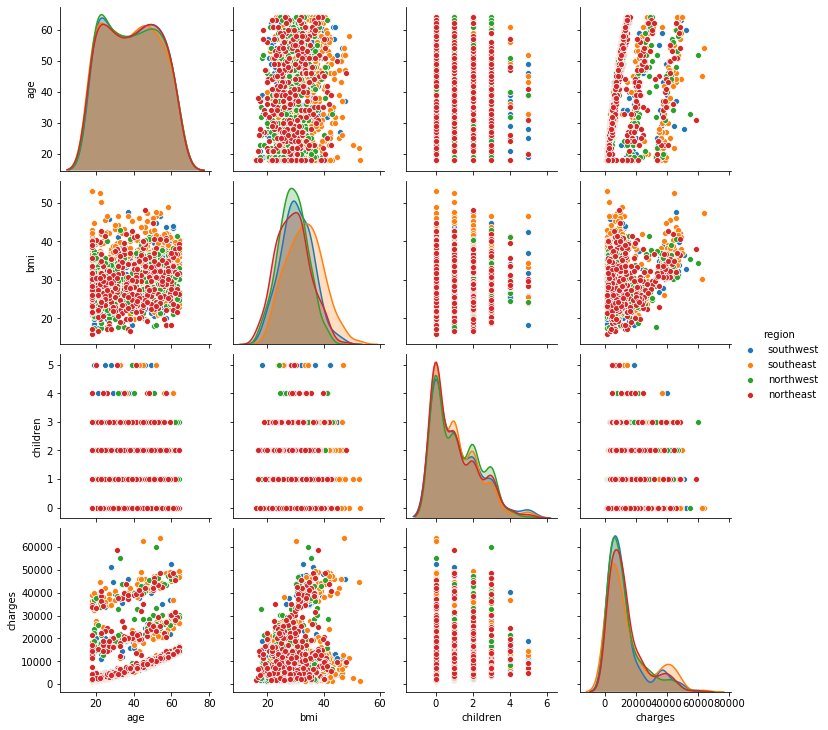

In [ ]:
sns.pairplot(data, hue="region", height=2.5)

In [ ]:
data.describe()

,age,bmi,children,charges
count,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,30.663397,1.094918,13270.422265
std,14.049960,6.098187,1.205493,12110.011237
min,18.000000,15.960000,0.000000,1121.873900
25%,27.000000,26.296250,0.000000,4740.287150
50%,39.000000,30.400000,1.000000,9382.033000
75%,51.000000,34.693750,2.000000,16639.912515
max,64.000000,53.130000,5.000000,63770.428010


In [ ]:
print(data['sex'].value_counts())
print('\n')
print(data['smoker'].value_counts())
print('\n')
print(data['region'].value_counts())

male      676
female    662
Name: sex, dtype: int64


no     1064
yes     274
Name: smoker, dtype: int64


southeast    364
southwest    325
northwest    325
northeast    324
Name: region, dtype: int64


## Visualising our Results

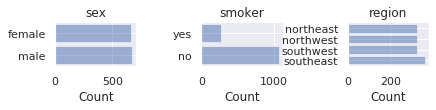

In [ ]:
import seaborn as sns
import numpy as np
sns.set(rc={'figure.figsize':(6.7,2.27)})
fig = plt.figure()
fig.subplots_adjust(hspace=0.8, wspace=0.8)
attr = ['sex','smoker','region']
for i in range(0,3):
    ax = fig.add_subplot(2, 3, i+1)
    counts = data[attr[i]].value_counts()
    myproblems = list(counts.index)
    my_problem_counts = list(counts)
    y_pos = np.arange(len(myproblems))
    plt.barh(y_pos, my_problem_counts, align='center', alpha=0.5)
    plt.yticks(y_pos, myproblems)
    plt.xlabel('Count')
    plt.title(attr[i])

# Pair Plots for our encoded data

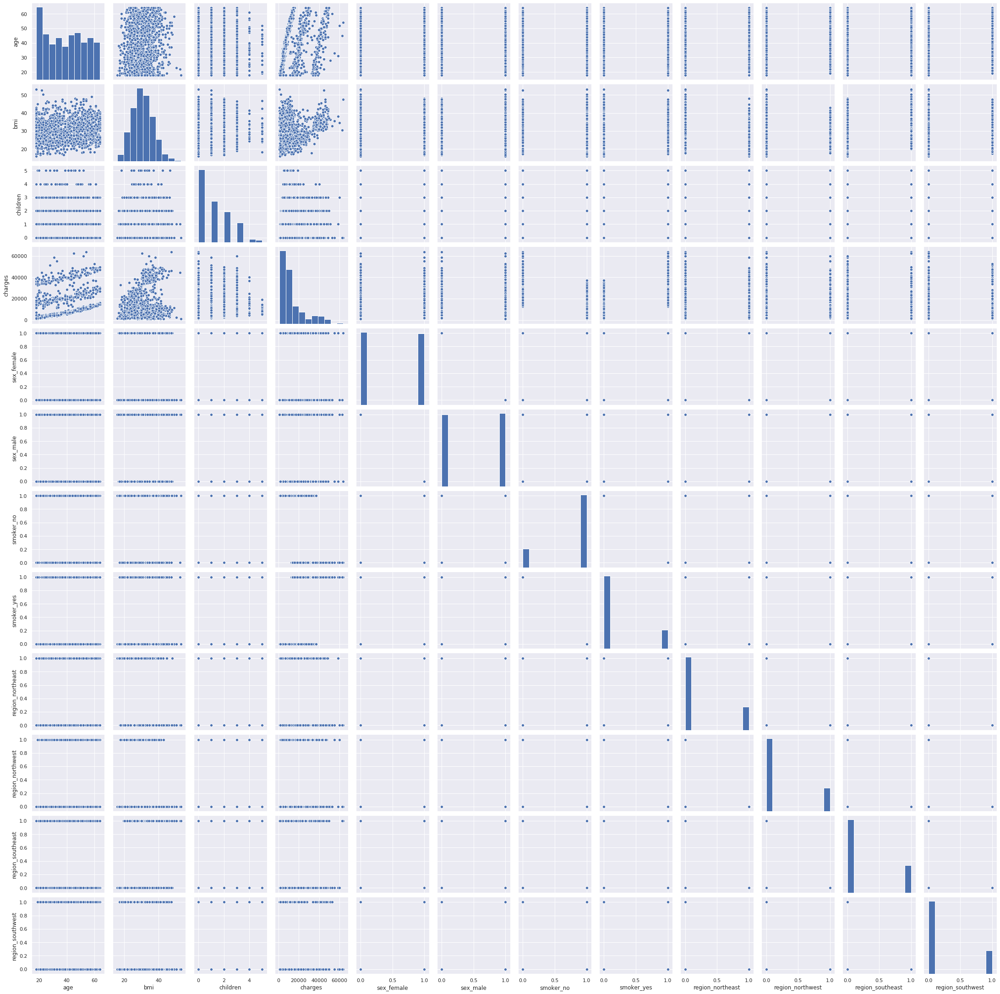

In [ ]:
sns.pairplot(encoded_data, height=2.5)

In [ ]:
encoded_data.describe()


,age,bmi,children,charges,sex_female,sex_male,smoker_no,smoker_yes,region_northeast,region_northwest,region_southeast,region_southwest
count,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,30.663397,1.094918,13270.422265,0.494768,0.505232,0.795217,0.204783,0.242152,0.242900,0.272048,0.242900
std,14.049960,6.098187,1.205493,12110.011237,0.500160,0.500160,0.403694,0.403694,0.428546,0.428995,0.445181,0.428995
min,18.000000,15.960000,0.000000,1121.873900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,26.296250,0.000000,4740.287150,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,39.000000,30.400000,1.000000,9382.033000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,51.000000,34.693750,2.000000,16639.912515,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000
max,64.000000,53.130000,5.000000,63770.428010,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# <font color='red'>By Default Sklearn uses Ordinary Least squares for regression </font>

In [ ]:
encoded_data[encoded_data.columns[~encoded_data.columns.isin(['charges'])]].to_numpy()

array([[19.  , 27.9 ,  0.  , ...,  0.  ,  0.  ,  1.  ],
       [18.  , 33.77,  1.  , ...,  0.  ,  1.  ,  0.  ],
       [28.  , 33.  ,  3.  , ...,  0.  ,  1.  ,  0.  ],
       ...,
       [18.  , 36.85,  0.  , ...,  0.  ,  1.  ,  0.  ],
       [21.  , 25.8 ,  0.  , ...,  0.  ,  0.  ,  1.  ],
       [61.  , 29.07,  0.  , ...,  1.  ,  0.  ,  0.  ]])

In [ ]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression 

X = encoded_data[encoded_data.columns[~encoded_data.columns.isin(['charges'])]].to_numpy()
y = encoded_data.charges.to_numpy()

# Dropping any rows with Nan values 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25) 


# Splitting the data into training and testing data 
regr = LinearRegression() 
  
regr.fit(X_train, y_train) 

print(regr.score(X_test, y_test)) # R squared score


0.7714676730352622


# Thats the end of Today's work

Resources
## 1.[Mathematical Intuition of OLS](https://towardsdatascience.com/understanding-the-ols-method-for-simple-linear-regression-e0a4e8f692cc)

## 2. [R squared](https://www.youtube.com/watch?v=WuuyD3Yr-js)

In [ ]:
# # from sklearn import datasets, linear_model
# # from sklearn.linear_model import LinearRegression
# import statsmodels.api as sm
# from scipy import stats

# X = encoded_data[encoded_data.columns[~encoded_data.columns.isin(['charges'])]].to_numpy()
# y = encoded_data.charges.to_numpy()

# X2 = sm.add_constant(X)
# est = sm.OLS(y, X2)
# est2 = est.fit()
# print(est2.summary())

In [ ]:
# encoded_data.columns[~encoded_data.columns.isin(['charges'])]

In [ ]:
# import statsmodels.api as sm
# from scipy import stats

# X = encoded_data[encoded_data.columns[~encoded_data.columns.isin(['charges'])]].to_numpy()
# y = encoded_data.charges.to_numpy()

# X2 = sm.add_constant(X)
# est = sm.OLS(y, X2)
# est2 = est.fit()
# print(est2.summary())